In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys

In [48]:
data = pd.read_csv('data/data.csv')

In [49]:
data.columns

Index(['time', 'weathercode', 'temperature_2m_max', 'temperature_2m_min',
       'temperature_2m_mean', 'apparent_temperature_max',
       'apparent_temperature_min', 'apparent_temperature_mean', 'sunrise',
       'sunset', 'shortwave_radiation_sum', 'precipitation_sum', 'rain_sum',
       'snowfall_sum', 'precipitation_hours', 'windspeed_10m_max',
       'windgusts_10m_max', 'winddirection_10m_dominant',
       'et0_fao_evapotranspiration', 'latitude', 'longitude', 'elevation',
       'country', 'city'],
      dtype='object')

In [50]:
columns = ['temperature_2m_max', 'temperature_2m_min',
       'temperature_2m_mean', 'apparent_temperature_max',
       'apparent_temperature_min', 'apparent_temperature_mean', 
       'shortwave_radiation_sum', 'precipitation_sum', 'rain_sum', 
       'precipitation_hours', 'windspeed_10m_max',
       'windgusts_10m_max', 'winddirection_10m_dominant',
       'et0_fao_evapotranspiration']

In [51]:
len(columns)

14

In [19]:
# for each column in columns list, find the mean value of the each column grouped by the 'city' column and create a new dataset with the mean values for each city
grouped = data.groupby('city')[columns].mean().reset_index()

In [42]:
columns = ['temperature_2m_max', 'temperature_2m_min',
       'temperature_2m_mean', 'apparent_temperature_max',
       'apparent_temperature_min', 'apparent_temperature_mean', 
       'shortwave_radiation_sum', 'precipitation_sum', 'rain_sum', 
       'precipitation_hours', 'windspeed_10m_max',
       'windgusts_10m_max', 'winddirection_10m_dominant',
       'et0_fao_evapotranspiration']

# plot the variation of 'temperature_2m_max' feature over time (time feature) for each city (city feature)
cities = data['city'].unique()

data2 = data[['time', 'city', 'temperature_2m_max']]
data2['time'] = data2['time'].str.split('T').str[0]
data2['time'] = pd.to_datetime(data2['time'])
data2.set_index('time', inplace=True)
monthly_data = data2.groupby(['city', pd.Grouper(freq='M')]).mean().reset_index()
# monthly_data.reset_index(drop=True, inplace=True)

plt.figure(figsize=(15, 7))
for city in cities:
    city_data = monthly_data[monthly_data['city'] == city]
    plt.plot(city_data['time'], city_data['temperature_2m_max'], label=city)

plt.title('Monthly Variation of Max Temperature at 2m Over Time for Each City')
plt.xlabel('Time')
plt.ylabel('Max Temperature at 2m (°C)')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

C:\Users\nisal\AppData\Local\Temp\ipykernel_25680\1217539138.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data2['time'] = data2['time'].str.split('T').str[0]
C:\Users\nisal\AppData\Local\Temp\ipykernel_25680\1217539138.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data2['time'] = pd.to_datetime(data2['time'])


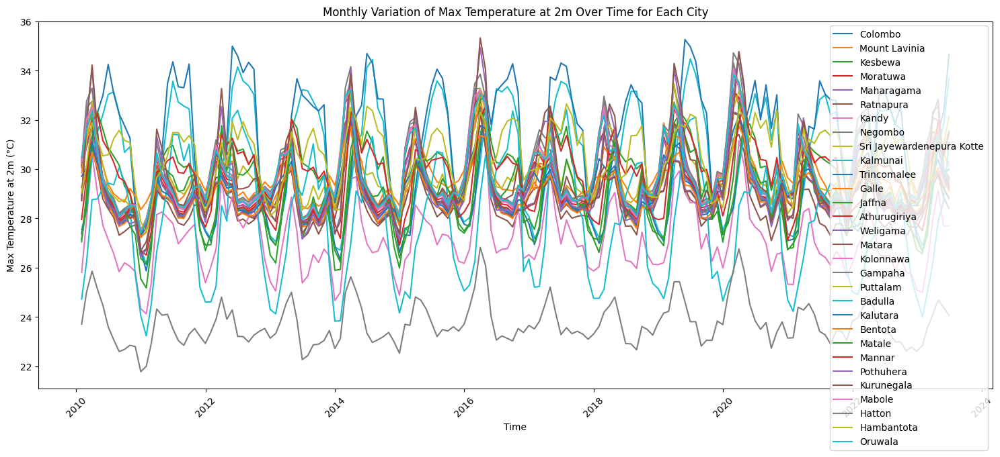

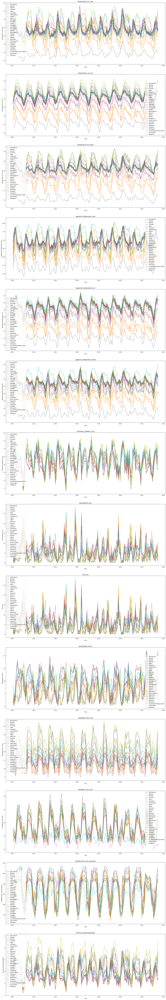

In [60]:
# Convert 'time' column to datetime and set as index
data1 = data.copy()
data1['time'] = pd.to_datetime(data1['time'].str.split('T').str[0])
data1.set_index('time', inplace=True)

# Group by 'city' and 'time' frequency for each column

# Create a figure with a 1x14 grid of subplots
fig, axes = plt.subplots(len(columns), 1, figsize=(20, 120))
# print(data1.columns)
# Loop through each column and plot in its corresponding subplot
for idx, col in enumerate(columns):
      data2 = data1.loc[:, ['city', col]]
      monthly_data = data2.groupby(['city', pd.Grouper(freq='M')]).mean().reset_index()

      ax = axes[idx]  # Get the appropriate axis
      for city in monthly_data['city'].unique():
            city_data = monthly_data[monthly_data['city'] == city]
            ax.plot(city_data['time'], city_data[col], label=city)
      ax.set_title(col)
      ax.set_xlabel('Time')
      ax.set_ylabel(col)
      ax.legend()
      # ax.xticks(rotation=45)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

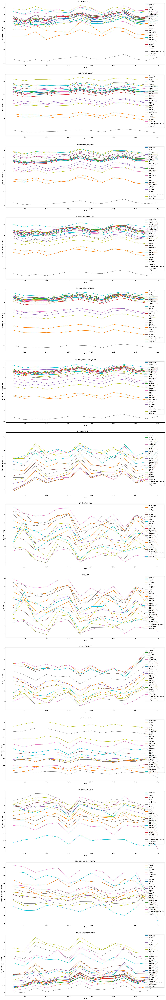

In [62]:
# Convert 'time' column to datetime and set as index
data1 = data.copy()
data1['time'] = pd.to_datetime(data1['time'].str.split('T').str[0])
data1.set_index('time', inplace=True)

# Group by 'city' and 'time' frequency for each column

# Create a figure with a 1x14 grid of subplots
fig, axes = plt.subplots(len(columns), 1, figsize=(20, 120))
# print(data1.columns)
# Loop through each column and plot in its corresponding subplot
for idx, col in enumerate(columns):
      data2 = data1.loc[:, ['city', col]]
      monthly_data = data2.groupby(['city', pd.Grouper(freq='Y')]).mean().reset_index()

      ax = axes[idx]  # Get the appropriate axis
      for city in monthly_data['city'].unique():
            city_data = monthly_data[monthly_data['city'] == city]
            ax.plot(city_data['time'], city_data[col], label=city)
      ax.set_title(col)
      ax.set_xlabel('Time')
      ax.set_ylabel(col)
      ax.legend(loc='upper right')
      # ax.xticks(rotation=45)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()

In [64]:
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder

# Load the dataset
data = pd.read_csv("data/data.csv")
print("Dataset loaded successfully")

# Drop irrelevant features
data = data.drop(["country", "longitude", "latitude"], axis=1)

# Extract city names
cities = data["city"]
data = data.drop(["city"], axis=1)

# Normalize the data
data = (data - data.mean()) / data.std()
print("Data normalized successfully")

# Convert the data to a TensorFlow tensor
data_tensor = tf.convert_to_tensor(data.values, dtype=tf.float32)
print("Data converted to tensor successfully")

# Encode city names
label_encoder = LabelEncoder()
city_labels = label_encoder.fit_transform(cities)
print("City names encoded successfully")


# Self-Organizing Map (SOM) class
class SOM(tf.Module):
    def __init__(self, input_size, map_size):
        self.input_size = input_size
        self.map_size = map_size
        self.weights = tf.Variable(
            tf.random.normal(shape=(map_size[0] * map_size[1], input_size))
        )
        print("SOM initialized successfully")

    def find_winner(self, input_vector):
        distances = tf.norm(self.weights - input_vector, axis=1)
        return tf.argmin(distances)

    def update_weights(self, winner, input_vector, learning_rate, radius):
        winner_pos = tf.unravel_index(winner, self.map_size)
        for i in range(self.map_size[0]):
            for j in range(self.map_size[1]):
                dist = tf.norm(
                    tf.convert_to_tensor([i, j])
                    - tf.convert_to_tensor(winner_pos, dtype=tf.float32)
                )
                influence = tf.exp(-dist / (2 * radius**2))
                self.weights[i * self.map_size[1] + j].assign_add(
                    learning_rate
                    * influence
                    * (input_vector - self.weights[i * self.map_size[1] + j])
                )

    def train(self, data, num_epochs=100, learning_rate=0.1, radius=2.0):
        for epoch in range(num_epochs):
            if epoch % 10 == 0:
                print("Epoch: {}/{}".format(epoch + 1, num_epochs))

            for input_vector in data:
                winner = self.find_winner(input_vector)
                self.update_weights(winner, input_vector, learning_rate, radius)
            radius *= 0.9  # Reduce the radius over time
            learning_rate *= 0.9  # Reduce the learning rate over time


# Example usage
input_size = data.shape[1]
map_size = (10, 10)
som = SOM(input_size, map_size)
som.train(data_tensor)